# Moran's I Figure

In [1]:
import scanpy as sc
import cellbin_moran as cm
import squidpy as sq
import anndata as ad
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from concurrent.futures import ProcessPoolExecutor, ThreadPoolExecutor, as_completed

# Scanpy Settings
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

-----
anndata     0.10.7
scanpy      1.10.1
-----
PIL                         9.2.0
anyio                       NA
arrow                       1.3.0
asciitree                   NA
asttokens                   NA
attr                        23.2.0
attrs                       23.2.0
babel                       2.14.0
brotli                      1.1.0
cellbin_moran               NA
certifi                     2024.02.02
cffi                        1.16.0
charset_normalizer          3.3.2
cloudpickle                 3.0.0
colorama                    0.4.6
comm                        0.2.2
cycler                      0.12.1
cython_runtime              NA
dask                        2024.4.2
dask_expr                   1.0.13
dask_image                  2023.08.1
datashader                  0.16.1
datatree                    0.0.14
dateutil                    2.9.0
debugpy                     1.8.1
decorator                   5.1.1
defusedxml                  0.7.1
dill                       

In [2]:
dir_path = "/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp"

In [48]:
cellpaths = cm.list_files_matching_criteria(dir_path, "01", separator = ".")

In [49]:
cellpaths

{'HZ12M01_Basal forebrain': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ12M01_Basal forebrain.h5ad',
 'HZ12M01_Hippocampal formation': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ12M01_Hippocampal formation.h5ad',
 'HZ12M01_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ12M01_Prefrontal cortex.h5ad',
 'HZ12M01_Striatum': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ12M01_Striatum.h5ad',
 'HZ2M01_Basal forebrain': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ2M01_Basal forebrain.h5ad',
 'HZ2M01_Hippocampal formation': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ2M01_Hippocampal formation.h5ad',
 'HZ2M01_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ2M01_Prefrontal cortex.h5ad',
 'HZ2M01_Striatum': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bi

In [104]:
cellbins = cm.load_data_in_parallel(cellpaths, sc.read_h5ad)

In [51]:
cellbins

{'HZ12M01_Basal forebrain': AnnData object with n_obs × n_vars = 9356 × 873
     obs: 'Unnamed: 0', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'fine', 'genotype', 'month', 'sample', 'slice', 'id_A', 'age', 'nearest_plaque', 'interval', 'min_center_dist', 'min_border_dist', 'plaque_region', 'celltype', 'nCount_SCT', 'nFeature_SCT', 'nearest_index', 'struct_id', 'acronym_x', 'id_B', 'atlas_id', 'name', 'acronym_y', 'st_level', 'ontology_id', 'hemisphere_id', 'weight', 'parent_structure_id', 'depth', 'graph_id', 'graph_order', 'structure_id_path', 'color_hex_triplet', 'neuro_name_structure_id', 'neuro_name_structure_id_path', 'failed', 'sphinx_id', 'structure_name_facet', 'failed_facet', 'safe_name', 'total_voxel_counts (10 um)', 'Structure independently delineated (not merged to form parents)', 'Major Division', '"Summary Structure" Level for Analyses', 'Structure Name', 'nCount_RNA', 'nFeature_RNA', 'batch', 'plaque', 'plaque_delta', 'percent.mito', 'p

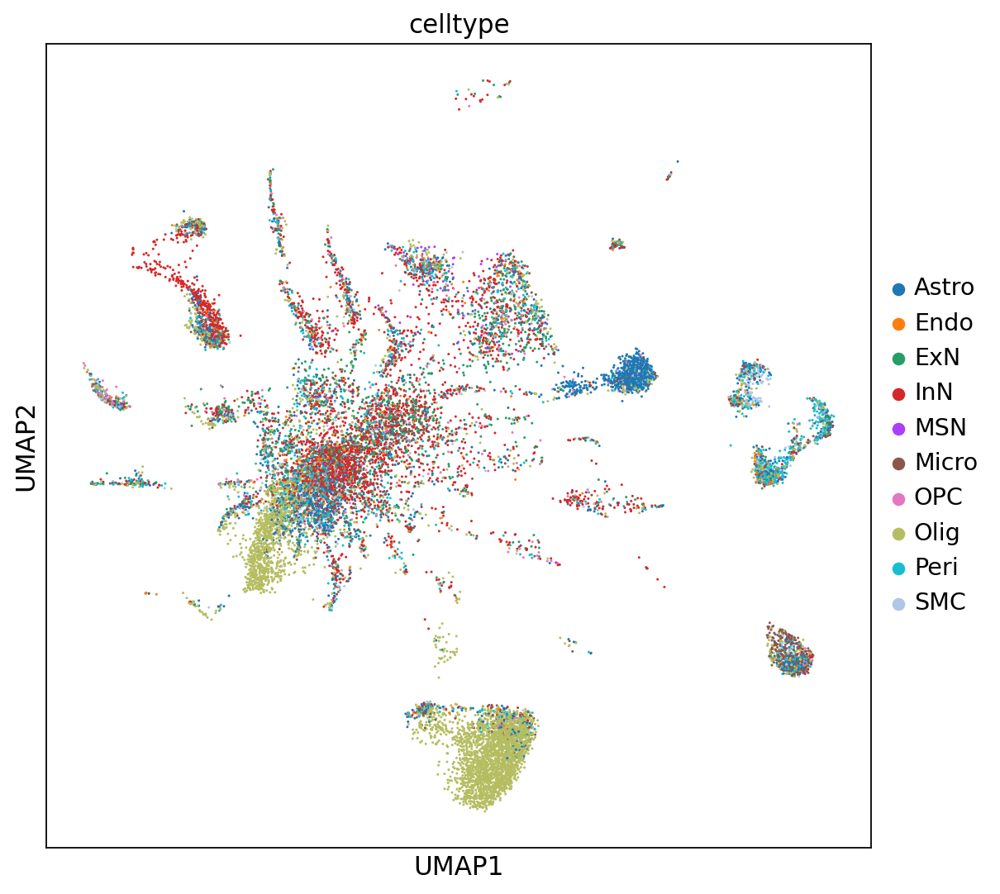

In [55]:
sc.pl.umap(cellbins["HZ4MP101_Basal forebrain"], color = "celltype")

In [20]:
adata.obs["celltype"].unique()

['InN', 'Olig', 'MSN', 'ExN', 'Micro', 'Astro', 'Peri', 'Endo', 'OPC', 'SMC']
Categories (10, object): ['Astro', 'Endo', 'ExN', 'InN', ..., 'OPC', 'Olig', 'Peri', 'SMC']

count    0.0
mean     NaN
std      NaN
min      NaN
25%      NaN
50%      NaN
75%      NaN
max      NaN
Name: min_center_dist, dtype: float64

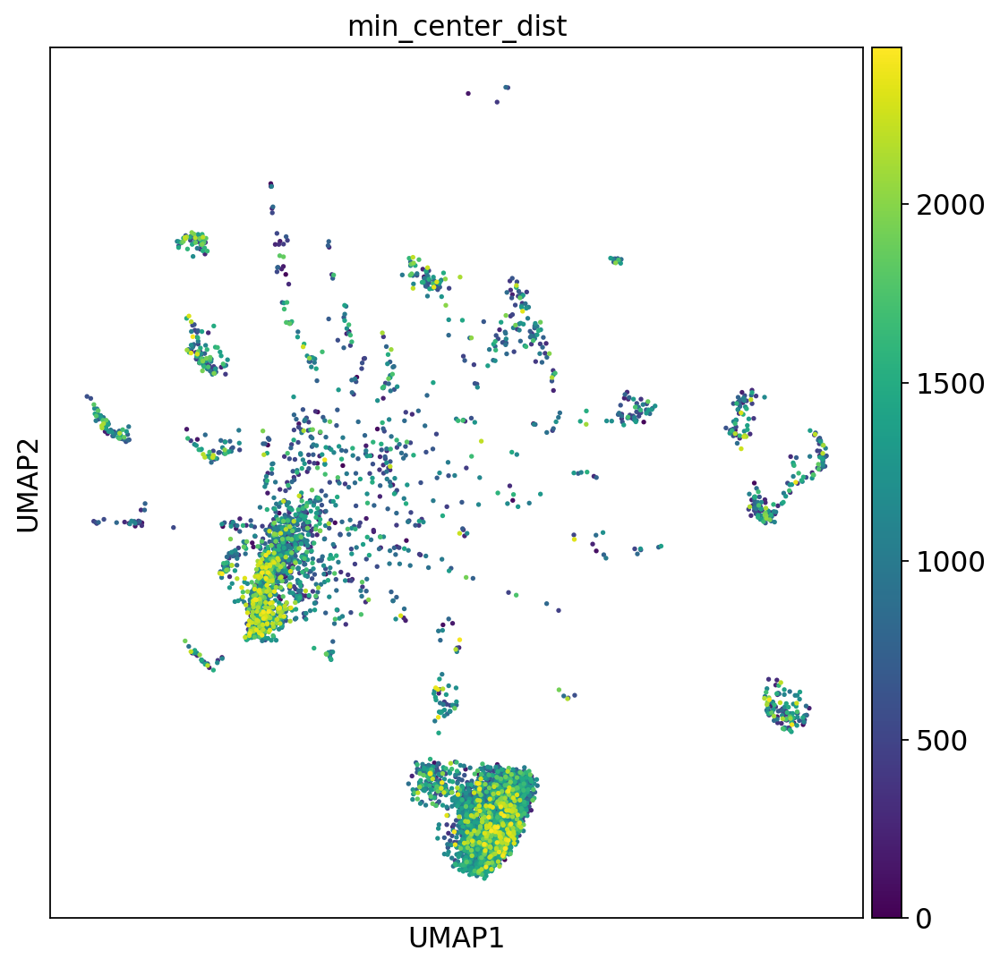

In [57]:
adata = cellbins["HZ4MP101_Basal forebrain"].copy()
mask = adata.obs["celltype"] == "Olig"
sc.pl.umap(adata[mask], color=["min_center_dist"])


In [46]:
adata.obs["min_center_dist"].describe()

count    51608.000000
mean       576.847761
std        347.987350
min          0.000000
25%        308.602495
50%        536.783681
75%        786.765774
max       1809.987722
Name: min_center_dist, dtype: float64

# True Figure

/tmp/ipykernel_253085/1672825407.py:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  type(slide["HZ12M01_Prefrontal cortex"].obs["celltype"][0])


str

In [351]:
def plot_normalized_umap(
    slide: dict,
    num_rows: int = 1,
    num_cols: int = 7,
    cell_type: str = "Micro",
    color: str = "min_center_dist",
    palette: dict = None,
    **umap_kwargs
) -> plt.Figure:
    """
    Plots a grid of UMAP projections with normalized values for each AnnData object in 'slide'.

    Args:
        slide: Dictionary where keys are identifiers and values are AnnData objects.
        num_rows: Number of rows in the subplot grid.
        num_cols: Number of columns in the subplot grid.
        cell_type: The cell type to filter on for plotting. If None, plot all cells.
        color: The column name in `adata.obs` to normalize and plot.
        palette: Optional dictionary specifying the color palette to use if 'color' is categorical.
        **umap_kwargs: Arbitrary keyword arguments to pass to the `sc.pl.umap` function.

    Returns:
        plt.Figure: The matplotlib figure object.
    """
    def normalize(values):
        min_val = values.min()
        max_val = values.max()
        return (values - min_val) / (max_val - min_val)

    # Determine the number of subplots needed
    # num_plots = len(slide)
    # Create a grid of subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4), gridspec_kw={'width_ratios': [1] * num_cols})
    axes = axes.flatten()  # Flatten the array to easily iterate through it

    # Rearrange the slide items to start with the second key and put the first key last
    slide_items = list(slide.items())
    slide_items = slide_items[1:] + slide_items[:1]

    # Plot each adata in the appropriate subplot
    for i, (key, adata) in enumerate(slide_items):
        tmp = adata.copy()
        if i >= len(axes):  # Prevent indexing errors if there are more slides than subplots
            break
        if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
            leg_stat = None
        else:
            leg_stat = "right margin"

        if cell_type:
            mask = tmp.obs["celltype"] == cell_type
        else:
            mask = slice(None)  # Select all cells if cell_type is None

        if color == "min_center_dist":
            tmp.obs.loc[mask, f"{color}_normalized"] = normalize(tmp.obs.loc[mask, color])
            plot_color = f"{color}_normalized"
        else:
            plot_color = color

        sc.pl.umap(tmp[mask], color=plot_color, vmin=0, vmax=1 if color == "min_center_dist" else None, ax=axes[i], show=False, colorbar_loc=None, legend_loc=leg_stat, palette=palette, **umap_kwargs)
        axes[i].set_title(key.split(sep="_")[0])
        for pos in ['top', 'bottom', 'left']:
            axes[i].spines[pos].set_visible(False)
        axes[i].set_xlabel("")
        axes[i].set_ylabel("")

    # Add an axis for the color bar on the right border if color is numerical and default
    if isinstance(tmp.obs[color][0], (int, float, complex)):
        cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
        norm = plt.Normalize(vmin=0, vmax=1)
        sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
        sm.set_array([])
        cbar = fig.colorbar(sm, cax=cbar_ax)
        cbar.set_label(f'{color}_normalized')

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar
    return fig

def save_figure_to_pdf(fig: plt.Figure, filename: str, dpi: int = 350) -> None:
    """
    Saves the given figure object to a PDF file.

    Args:
        fig: The matplotlib figure object to save.
        filename: The name of the output PDF file.
        dpi: The resolution of the output PDF file.
    """
    from matplotlib.backends.backend_pdf import PdfPages
    with PdfPages(filename) as pdf:
        fig.savefig(pdf, format='pdf', dpi=dpi)


In [ ]:
plt.vlines()

## Prefrontal cortex

In [107]:
slide = {}
for key, adata in cellbins.items():
    if "Prefrontal cortex" in key:
        print(key)
        slide[key] = adata.copy()

HZ12M01_Prefrontal cortex
HZ2M01_Prefrontal cortex
HZ3M01_Prefrontal cortex
HZ4MP101_Prefrontal cortex
HZ5M01_Prefrontal cortex
HZ6MP101_Prefrontal cortex
HZ8M01_Prefrontal cortex


/tmp/ipykernel_253085/2901374371.py:43: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/2901374371.py:68: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/2901374371.py:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


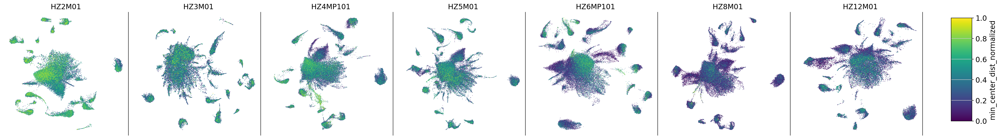

In [327]:
overall_dist = plot_normalized_umap(slide, cell_type=None)
save_figure_to_pdf(overall_dist, filename="../test_fig/overall_dist.pdf")

/tmp/ipykernel_253085/4108466287.py:18: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/4108466287.py:45: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/4108466287.py:53: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


SyntaxError: 'return' outside function (4108466287.py, line 54)

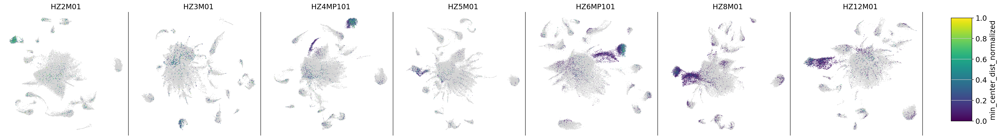

In [325]:
color = "min_center_dist"
num_rows = 1
num_cols = 7
cell_type = None

fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4), gridspec_kw={'width_ratios': [1] * num_cols})
axes = axes.flatten()  # Flatten the array to easily iterate through it

# Rearrange the slide items to start with the second key and put the first key last
slide_items = list(slide.items())
slide_items = slide_items[1:] + slide_items[:1]

# Plot each adata in the appropriate subplot
for i, (key, adata) in enumerate(slide_items):
    tmp = adata.copy()
    if i >= len(axes):  # Prevent indexing errors if there are more slides than subplots
        break
    if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
        leg_stat = None
    else:
        leg_stat = "right margin"

    if cell_type:
        mask = tmp.obs["celltype"] == cell_type
    else:
        mask = slice(None)  # Select all cells if cell_type is None

    if color == "min_center_dist":
        tmp.obs.loc[mask, f"{color}_normalized"] = normalize(tmp.obs.loc[mask, color])
        plot_color = f"{color}_normalized"
    else:
        plot_color = color

    sc.pl.umap(tmp[mask], color=plot_color, vmin=0, vmax=1 if color == "min_center_dist" else None, 
               ax=axes[i], show=False, colorbar_loc=None, legend_loc=leg_stat,
              mask_obs=(tmp.obs.celltype == "Micro"))
    
    axes[i].set_title(f"{key.split(sep='_')[0]} Microglial")
    for pos in ['top', 'bottom', 'left']:
        axes[i].spines[pos].set_visible(False)
    axes[i].set_xlabel("")
    axes[i].set_ylabel("")


# Add an axis for the color bar on the right border if color is numerical and default
if isinstance(tmp.obs[color][0], (int, float, complex)):
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    norm = plt.Normalize(vmin=0, vmax=1)
    sm = plt.cm.ScalarMappable(cmap="viridis", norm=norm)
    sm.set_array([])
    cbar = fig.colorbar(sm, cax=cbar_ax)
    cbar.set_label(f'{color}_normalized')

plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar

In [313]:
celltype_palette = {
    "ExN": "#FF3357",
    "InN": "#2B92DF",
    "Astro": "#FF7620",
    "Micro": "#820E56",
    "Olig": "#099963",
    "OPC": "#73E785",
    "Vas": "#523691",
    "Endo": "#996B2D",
    "Peri": "#858781",
    "SMC": "#825F45",
    "MSN":	"#0D46A0"
}


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "

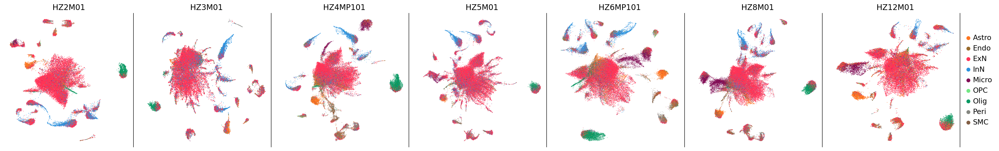

In [322]:
my_fig = plot_normalized_umap(slide, cell_type=None, color = "celltype", palette=celltype_palette)

/tmp/ipykernel_253085/3128845079.py:45: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/3128845079.py:69: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/3128845079.py:77: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


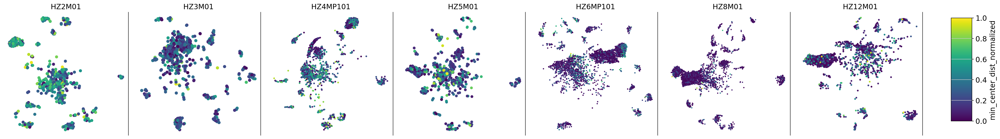

In [354]:
micro_dist = plot_normalized_umap(slide, cell_type="Micro", sort_order = False)

/tmp/ipykernel_253085/2901374371.py:43: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/2901374371.py:68: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/2901374371.py:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


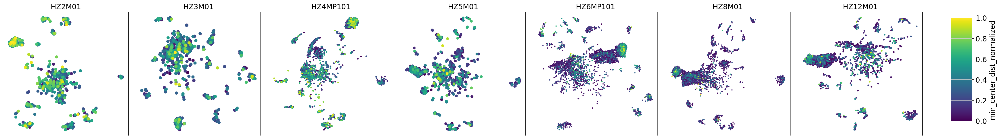

In [328]:
micro_dist = plot_normalized_umap(slide, cell_type="Micro")
save_figure_to_pdf(micro_dist, filename="../test_fig/micro_dist.pdf")

In [240]:
micropalette = {"Micro-1": "#B099FF", "Micro-2": "#450099",  "Micro-3": "#8481BA", "Micro-4": "#B395BD", }

/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "

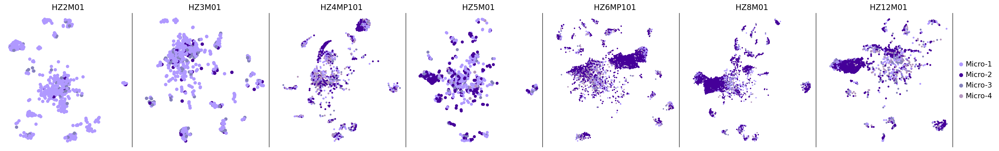

In [329]:
micro_fine = plot_normalized_umap(slide, cell_type="Micro", color = "fine", palette=micropalette)
save_figure_to_pdf(micro_fine, filename="../test_fig/micro_fine.pdf")

/tmp/ipykernel_253085/660956084.py:66: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


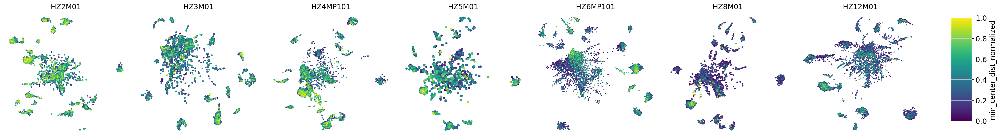

In [269]:
my_fig = plot_normalized_umap(slide, cell_type="Astro")

In [241]:
astropalette = {'Astro-1': '#FF8C00', 'Astro-2': '#FFC30A', 'Astro-3': '#F17F32', 'Astro-4': '#FFB77F', 'Astro-5': '#F39942', 'Astro-6': '#E9D134'}

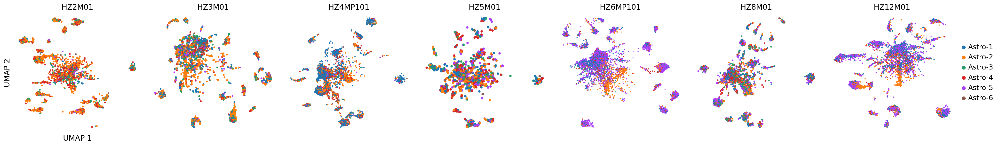

In [243]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np

# Determine the number of subplots needed
num_plots = len(slide)
num_rows = 1
num_cols = 7

# Create a 1x7 grid of subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(26, 4), gridspec_kw={'width_ratios': [1] * num_cols})
axes = axes.flatten()  # Flatten the 1x7 array to easily iterate through it

# Rearrange the slide items to start with the second key and put the first key last
slide_items = list(slide.items())
slide_items = slide_items[1:] + slide_items[:1]

# Plot each adata in the appropriate subplot
for i, (key, adata) in enumerate(slide_items):
    mask = adata.obs["celltype"] == "Astro"
    # Plot the normalized values
    adata_plot = adata[mask].copy()
    np.random.seed(0)
    random_indices = np.random.permutation(list(range(adata_plot.shape[0]))) # shuffle the cells
    adata_plot = adata_plot[random_indices, :].copy()
    sc.pl.umap(adata_plot, color="fine", ax=axes[i], show=False)
    axes[i].set_title(key.split(sep = "_")[0])
    for pos in ['right', 'top', 'bottom', 'left']: 
        axes[i].spines[pos].set_visible(False)
    
    # Only set the x and y labels for the lower-left corner plot
    if i == 0:
        axes[i].set_xlabel("UMAP 1")
        axes[i].set_ylabel("UMAP 2")
    else:
        axes[i].set_xlabel("")
        axes[i].set_ylabel("")
    # Only add a legend to the last subplot (the rightmost one)
    if i != len(slide_items) - 1:  # Check if it’s the last plot
        axes[i].legend().set_visible(False)

plt.tight_layout()  # Adjust layout to make space for the color bar
plt.show()


/tmp/ipykernel_253085/3128845079.py:45: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/3128845079.py:69: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/3128845079.py:77: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


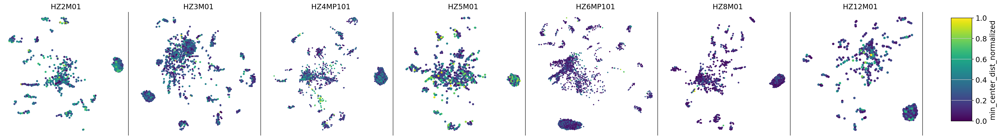

In [353]:
my_fig = plot_normalized_umap(slide, cell_type="Olig", sort_order = False)

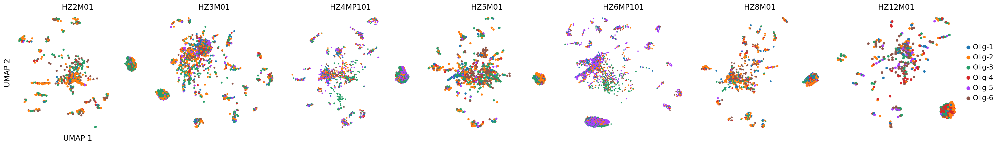

In [245]:
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np

# Determine the number of subplots needed
num_plots = len(slide)
num_rows = 1
num_cols = 7

# Create a 1x7 grid of subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(26, 4), gridspec_kw={'width_ratios': [1] * num_cols})
axes = axes.flatten()  # Flatten the 1x7 array to easily iterate through it

# Rearrange the slide items to start with the second key and put the first key last
slide_items = list(slide.items())
slide_items = slide_items[1:] + slide_items[:1]

# Plot each adata in the appropriate subplot
for i, (key, adata) in enumerate(slide_items):
    mask = adata.obs["celltype"] == "Olig"
    # Plot the normalized values
    adata_plot = adata[mask].copy()
    np.random.seed(0)
    random_indices = np.random.permutation(list(range(adata_plot.shape[0]))) # shuffle the cells
    adata_plot = adata_plot[random_indices, :].copy()
    sc.pl.umap(adata_plot, color="fine", ax=axes[i], show=False)
    axes[i].set_title(key.split(sep = "_")[0])
    for pos in ['right', 'top', 'bottom', 'left']: 
        axes[i].spines[pos].set_visible(False)
    
    # Only set the x and y labels for the lower-left corner plot
    if i == 0:
        axes[i].set_xlabel("UMAP 1")
        axes[i].set_ylabel("UMAP 2")
    else:
        axes[i].set_xlabel("")
        axes[i].set_ylabel("")
    # Only add a legend to the last subplot (the rightmost one)
    if i != len(slide_items) - 1:  # Check if it’s the last plot
        axes[i].legend().set_visible(False)

plt.tight_layout()  # Adjust layout to make space for the color bar
plt.show()


## Basal forebrain Region

In [330]:
bf = {}
for key, adata in cellbins.items():
    if "Basal forebrain" in key:
        print(key)
        bf[key] = adata.copy()

HZ12M01_Basal forebrain
HZ2M01_Basal forebrain
HZ3M01_Basal forebrain
HZ4MP101_Basal forebrain
HZ5M01_Basal forebrain
HZ6MP101_Basal forebrain
HZ8M01_Basal forebrain


/tmp/ipykernel_253085/2901374371.py:43: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/2901374371.py:68: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/2901374371.py:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


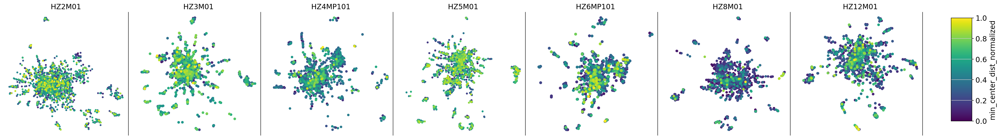

In [331]:
my_fig = plot_normalized_umap(bf, cell_type="ExN")

In [ ]:
my_fig = plot_normalized_umap(bf, cell_type="ExN")

## Striatum Region

In [267]:
striatum = {}
for key, adata in cellbins.items():
    if "Striatum" in key:
        print(key)
        striatum[key] = adata.copy()

HZ12M01_Striatum
HZ2M01_Striatum
HZ3M01_Striatum
HZ4MP101_Striatum
HZ5M01_Striatum
HZ6MP101_Striatum
HZ8M01_Striatum


In [268]:
striatum

{'HZ12M01_Striatum': AnnData object with n_obs × n_vars = 41159 × 882
     obs: 'Unnamed: 0', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'fine', 'genotype', 'month', 'sample', 'slice', 'id_A', 'age', 'nearest_plaque', 'interval', 'min_center_dist', 'min_border_dist', 'plaque_region', 'celltype', 'nCount_SCT', 'nFeature_SCT', 'nearest_index', 'struct_id', 'acronym_x', 'id_B', 'atlas_id', 'name', 'acronym_y', 'st_level', 'ontology_id', 'hemisphere_id', 'weight', 'parent_structure_id', 'depth', 'graph_id', 'graph_order', 'structure_id_path', 'color_hex_triplet', 'neuro_name_structure_id', 'neuro_name_structure_id_path', 'failed', 'sphinx_id', 'structure_name_facet', 'failed_facet', 'safe_name', 'total_voxel_counts (10 um)', 'Structure independently delineated (not merged to form parents)', 'Major Division', '"Summary Structure" Level for Analyses', 'Structure Name', 'nCount_RNA', 'nFeature_RNA', 'batch', 'plaque', 'plaque_delta', 'percent.mito', 'percent

/tmp/ipykernel_253085/660956084.py:66: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


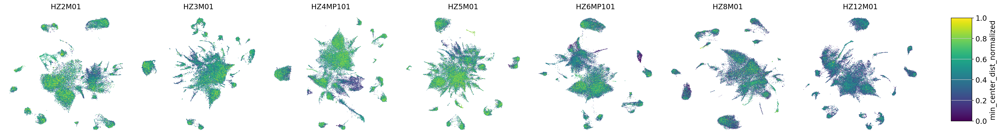

In [272]:
my_fig = plot_normalized_umap(striatum, cell_type=None)

/tmp/ipykernel_253085/3128845079.py:45: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if (i < len(axes) - 1) or isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/3128845079.py:69: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if isinstance(tmp.obs[color][0], (int, float, complex)):
/tmp/ipykernel_253085/3128845079.py:77: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make space for the color bar


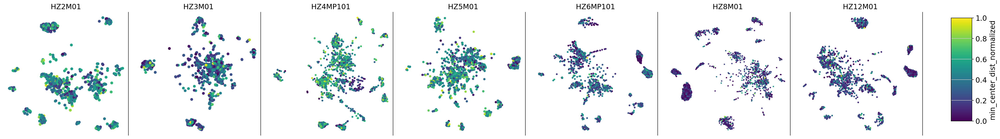

In [352]:
stiatum_micro = plot_normalized_umap(striatum, cell_type="Micro", sort_order = False)
save_figure_to_pdf(stiatum_micro, filename="../test_fig/stiatum_micro.pdf")

/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/scanpy/plotting/_utils.py:465: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "

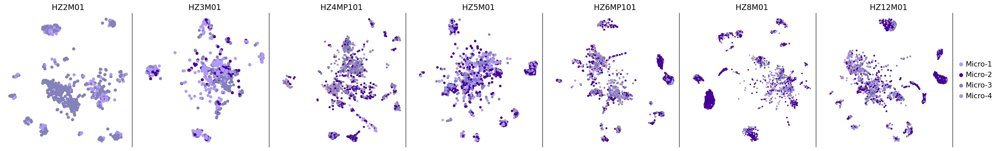

In [333]:
stiatum_micro_fine = plot_normalized_umap(striatum, cell_type="Micro", color = "fine", palette=micropalette)
save_figure_to_pdf(stiatum_micro_fine, filename="../test_fig/stiatum_micro_fine.pdf")

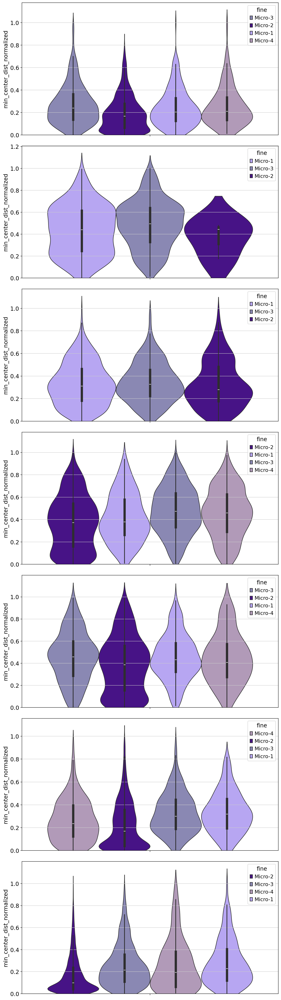

In [350]:
import seaborn as sns
import matplotlib.pyplot as plt

def normalize(values):
    min_val = values.min()
    max_val = values.max()
    return (values - min_val) / (max_val - min_val)


# Determine the number of plots needed
num_plots = len(striatum)

# Create a figure and a set of subplots
fig, axes = plt.subplots(num_plots, 1, figsize=(10, 5 * num_plots))

# If there's only one plot, axes is not a list, so we need to wrap it in a list
if num_plots == 1:
    axes = [axes]

# Iterate over striatum values and corresponding axes
for ax, adata in zip(axes, striatum.values()):
    mask = adata.obs["celltype"] == "Micro"
    filtered_data = adata.obs[mask]
    filtered_data = filtered_data.copy()
    filtered_data["fine"] = filtered_data["fine"].astype(str)
    
    filtered_data[f"{color}_normalized"] = normalize(filtered_data["min_center_dist"])
    plot_color = f"{color}_normalized"

    sns.violinplot(data=filtered_data, hue="fine", y=plot_color, ax=ax, palette=micropalette)
    # Set the upper limit for the y-axis
    ax.set_ylim(bottom=0)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


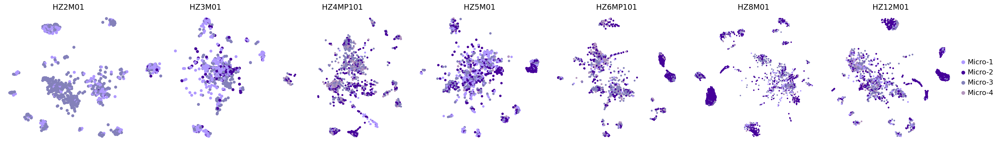

In [276]:
# Determine the number of subplots needed
num_plots = len(striatum)
num_rows = 1
num_cols = 7

# Create a 1x7 grid of subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(26, 4), gridspec_kw={'width_ratios': [1] * num_cols})
axes = axes.flatten()  # Flatten the 1x7 array to easily iterate through it

# Rearrange the striatum items to start with the second key and put the first key last
striatum_items = list(striatum.items())
striatum_items = striatum_items[1:] + striatum_items[:1]

# Plot each adata in the appropriate subplot
for i, (key, adata) in enumerate(striatum_items):
    mask = adata.obs["celltype"] == "Micro"
    # Plot the normalized values
    adata_plot = adata[mask].copy()
    np.random.seed(0)
    random_indices = np.random.permutation(list(range(adata_plot.shape[0]))) # shuffle the cells
    adata_plot = adata_plot[random_indices, :].copy()
    sc.pl.umap(adata_plot, color="fine", ax=axes[i], show=False, palette=micropalette)
    axes[i].set_title(key.split(sep = "_")[0])
    for pos in ['right', 'top', 'bottom', 'left']: 
        axes[i].spines[pos].set_visible(False)
    
    # Only set the x and y labels for the lower-left corner plot
        axes[i].set_xlabel("")
        axes[i].set_ylabel("")
    # Only add a legend to the last subplot (the rightmost one)
    if i != len(striatum_items) - 1:  # Check if it’s the last plot
        axes[i].legend().set_visible(False)

plt.tight_layout()  # Adjust layout to make space for the color bar
plt.show()


In [ ]:
my_fig = plot_normalized_umap(striatum, cell_type="Micro")

# Regress out same region in the same month

In [156]:
import cellbin_moran as cm

ModuleNotFoundError: No module named 'cm'

In [158]:
cellpaths = cm.list_files_matching_criteria(dir_path, "5M", separator = ".")

In [161]:
m5paths = {}
for key, value in cellpaths.items():
    if "Prefrontal cortex" in key:
        m5paths[key] = value

In [162]:
m5paths

{'HZ5M01_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ5M01_Prefrontal cortex.h5ad',
 'HZ5M02_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ5M02_Prefrontal cortex.h5ad',
 'HZ5M03_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ5M03_Prefrontal cortex.h5ad',
 'HZ5M04_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ5M04_Prefrontal cortex.h5ad',
 'HZ5M05_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ5M05_Prefrontal cortex.h5ad',
 'HZ5M06_Prefrontal cortex': '/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/morontemp/HZ5M06_Prefrontal cortex.h5ad'}

In [163]:
month_adata = cm.load_data_in_parallel(m5paths, sc.read_h5ad)

In [207]:
month_adata

{'HZ5M01_Prefrontal cortex': AnnData object with n_obs × n_vars = 51894 × 616
     obs: 'Unnamed: 0', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'fine', 'genotype', 'month', 'sample', 'slice', 'id_A', 'age', 'nearest_plaque', 'interval', 'min_center_dist', 'min_border_dist', 'plaque_region', 'celltype', 'nCount_SCT', 'nFeature_SCT', 'nearest_index', 'struct_id', 'acronym_x', 'id_B', 'atlas_id', 'name', 'acronym_y', 'st_level', 'ontology_id', 'hemisphere_id', 'weight', 'parent_structure_id', 'depth', 'graph_id', 'graph_order', 'structure_id_path', 'color_hex_triplet', 'neuro_name_structure_id', 'neuro_name_structure_id_path', 'failed', 'sphinx_id', 'structure_name_facet', 'failed_facet', 'safe_name', 'total_voxel_counts (10 um)', 'Structure independently delineated (not merged to form parents)', 'Major Division', '"Summary Structure" Level for Analyses', 'Structure Name', 'nCount_RNA', 'nFeature_RNA', 'batch', 'plaque', 'plaque_delta', 'percent.mito', 

In [208]:
for key, value in month_adata.items():
    month_adata[key].obs["batch"] = key

In [209]:
com_adata = ad.concat(list(month_adata.values()))

/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [175]:
region_dir = "/home1/jijh/st_project/cellbin_analysis/annotated_cell_bins/sn_sct_h5ad/"
region_files = os.listdir(region_dir)
region_paths = {file.split(sep = "_")[0]: os.path.join(region_dir, file) for file in region_files}

sn_ref = cm.load_sct_and_set_index(region_paths["PFC"])



array(['5xFAD', 'WT'], dtype=object)

In [183]:
mask = sn_ref.obs["genotype"] == "5xFAD"
sn_ad = sn_ref[mask].copy()

In [188]:
sn_ad.obs["datatype"] = "sn"

In [210]:
com_adata = cm.concatenate_and_intersect([com_adata, sn_ad])

/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [211]:
com_adata

AnnData object with n_obs × n_vars = 395067 × 212
    obs: 'Unnamed: 0', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'fine', 'genotype', 'month', 'sample', 'slice', 'id_A', 'age', 'nearest_plaque', 'interval', 'min_center_dist', 'min_border_dist', 'plaque_region', 'celltype', 'nCount_SCT', 'nFeature_SCT', 'nearest_index', 'struct_id', 'acronym_x', 'id_B', 'atlas_id', 'name', 'acronym_y', 'st_level', 'ontology_id', 'hemisphere_id', 'weight', 'parent_structure_id', 'depth', 'graph_id', 'graph_order', 'structure_id_path', 'color_hex_triplet', 'neuro_name_structure_id', 'neuro_name_structure_id_path', 'failed', 'sphinx_id', 'structure_name_facet', 'failed_facet', 'safe_name', 'total_voxel_counts (10 um)', 'Structure independently delineated (not merged to form parents)', 'Major Division', '"Summary Structure" Level for Analyses', 'Structure Name', 'nCount_RNA', 'nFeature_RNA', 'batch', 'plaque', 'plaque_delta', 'percent.mito', 'percent.rb', 'RNA_snn_res.0.

In [212]:
mask = com_adata.obs["datatype"] == "cellbin"
com_adata.obs[mask]["batch"].unique()

array(['HZ5M01_Prefrontal cortex', 'HZ5M02_Prefrontal cortex',
       'HZ5M03_Prefrontal cortex', 'HZ5M04_Prefrontal cortex',
       'HZ5M05_Prefrontal cortex', 'HZ5M06_Prefrontal cortex'],
      dtype=object)

In [213]:
# Perform harmony integration
sc.tl.pca(com_adata, svd_solver='arpack')
sc.external.pp.harmony_integrate(com_adata, basis = "X_pca", key="datatype")


mask = com_adata.obs["datatype"] == "cellbin"
cell_bin = com_adata[mask].copy()

sc.external.pp.harmony_integrate(cell_bin, basis = "X_pca_harmony", key="batch", adjusted_basis = "X_pca_har_har")





computing PCA
    with n_comps=50
    finished (0:00:17)


2024-05-21 03:01:50,312 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-21 03:04:56,581 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-21 03:05:01,327 - harmonypy - INFO - Iteration 1 of 10
2024-05-21 03:13:27,538 - harmonypy - INFO - Iteration 2 of 10
2024-05-21 03:22:26,617 - harmonypy - INFO - Iteration 3 of 10
2024-05-21 03:31:17,898 - harmonypy - INFO - Iteration 4 of 10
2024-05-21 03:36:33,918 - harmonypy - INFO - Iteration 5 of 10
2024-05-21 03:40:48,184 - harmonypy - INFO - Iteration 6 of 10
2024-05-21 03:44:46,035 - harmonypy - INFO - Converged after 6 iterations
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
2024-05-21 03:44:54,999 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-21 03:47:14,589 - harmonyp

computing neighbors


ValueError: Did not find X_pca_har_har in `.obsm.keys()`. You need to compute it first.

In [218]:
# Compute neighbors using the harmony-integrated PCA representation
sc.pp.neighbors(cell_bin, use_rep="X_pca_har_har")

# Compute UMAP
sc.tl.umap(cell_bin)

# Update UMAP coordinates to use the harmony-integrated ones
cell_bin.obsm["X_umap_har_har"] = cell_bin.obsm["X_umap"]

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:38)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:15:07)


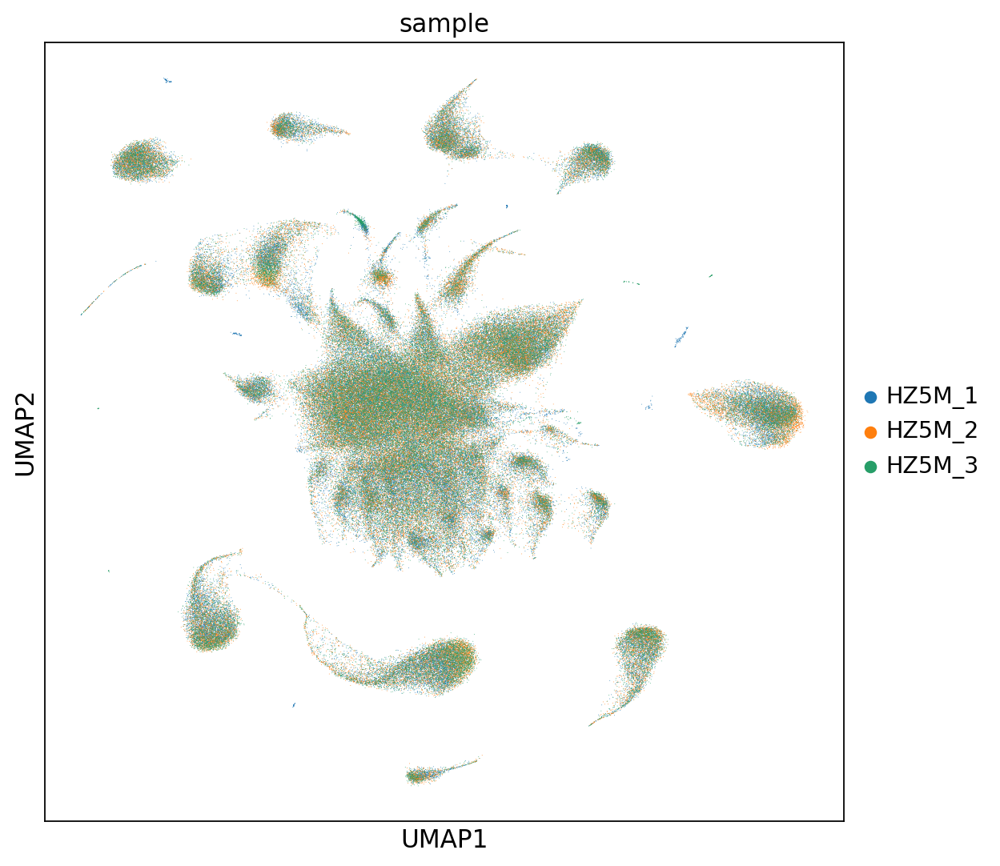

In [219]:
sc.pl.umap(cell_bin, color = "sample")

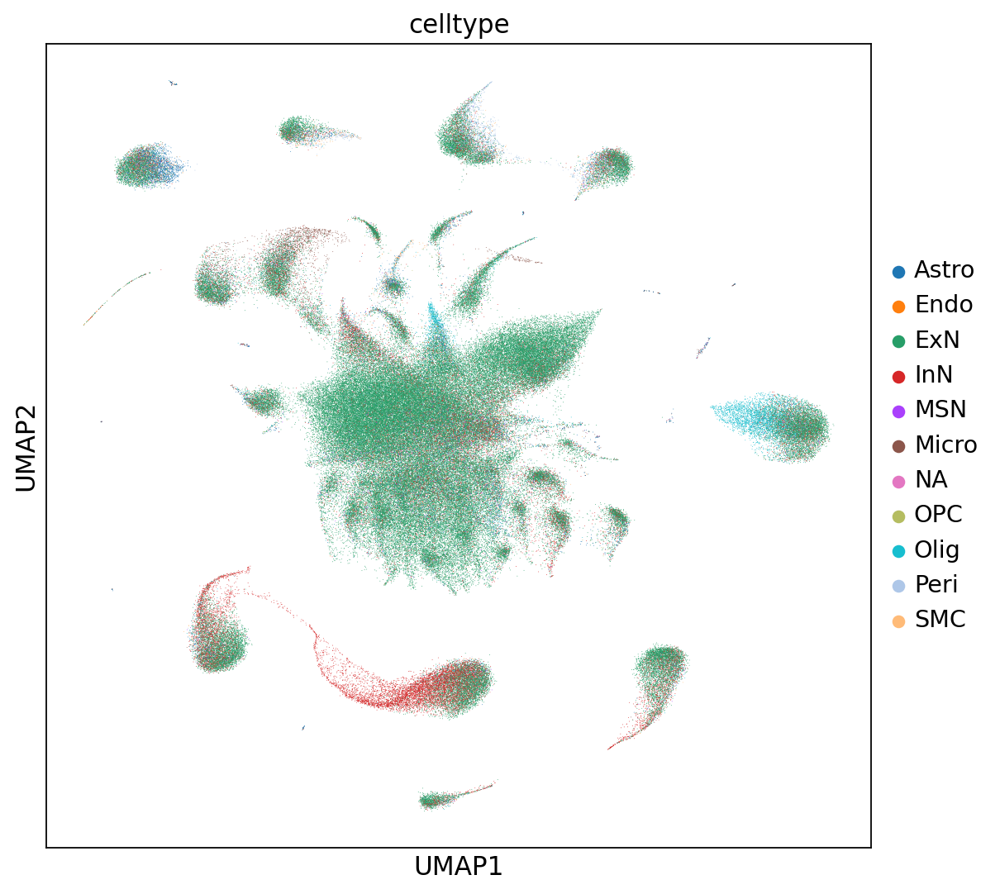

In [226]:
sc.pl.umap(cell_bin, color = "celltype")

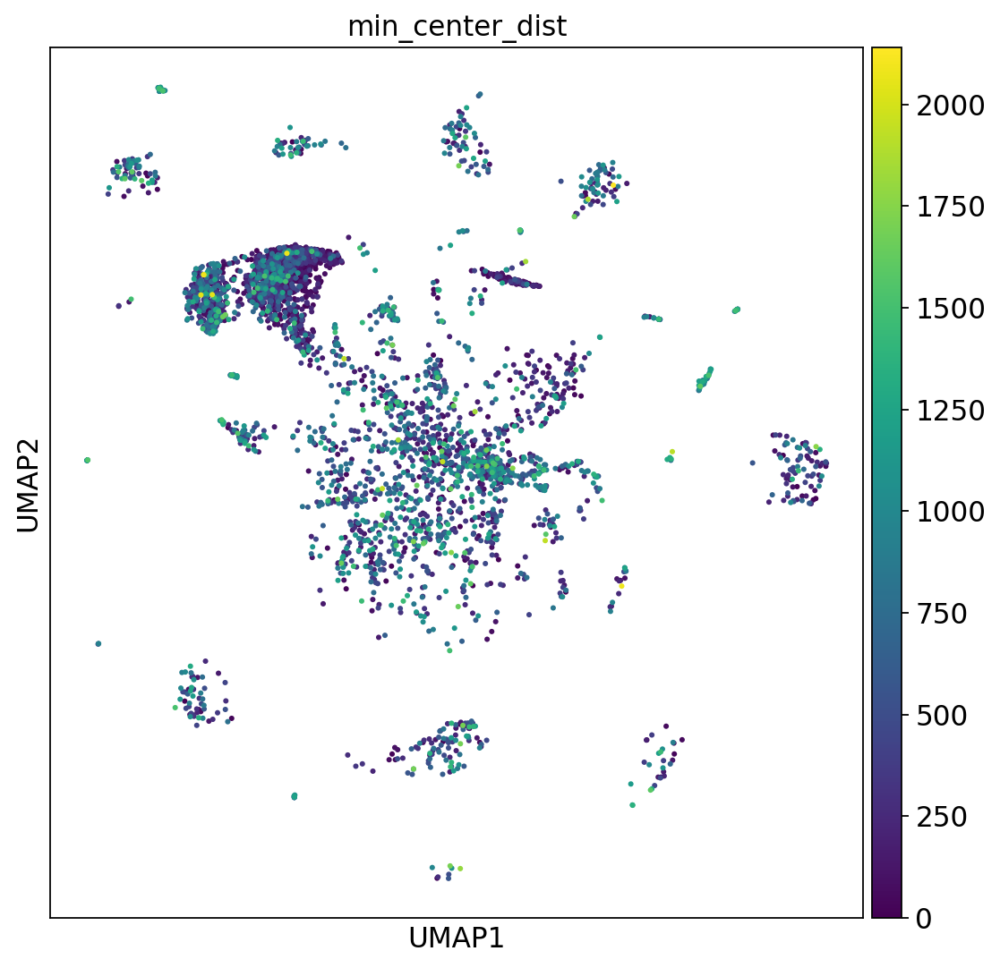

In [231]:
mask = cell_bin.obs["celltype"] == "Micro"
sc.pl.umap(cell_bin[mask], color = "min_center_dist")

In [216]:
cell_bin.obsm.keys()

KeysView(AxisArrays with keys: X_pca, X_pca_harmony, X_umap, X_umap_harmony, X_pca_har_har)

In [ ]:
mask = com_adata.obs["datatype"] == "cellbin"
cell_bin = com_adata[mask].copy()

In [ ]:
sc.external.pp.harmony_integrate(cell_bin, basis = "X_pca_harmony", key="batch", adjusted_basis = "X_pca_har_har")

In [170]:
# Compute neighbors using the harmony-integrated PCA representation
sc.pp.neighbors(com_adata, use_rep="X_pca_har_har")

# Compute UMAP
sc.tl.umap(com_adata)

# Update UMAP coordinates to use the harmony-integrated ones
com_adata.obsm["X_umap_har_har"] = com_adata.obsm["X_umap"]

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:44)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:14:26)


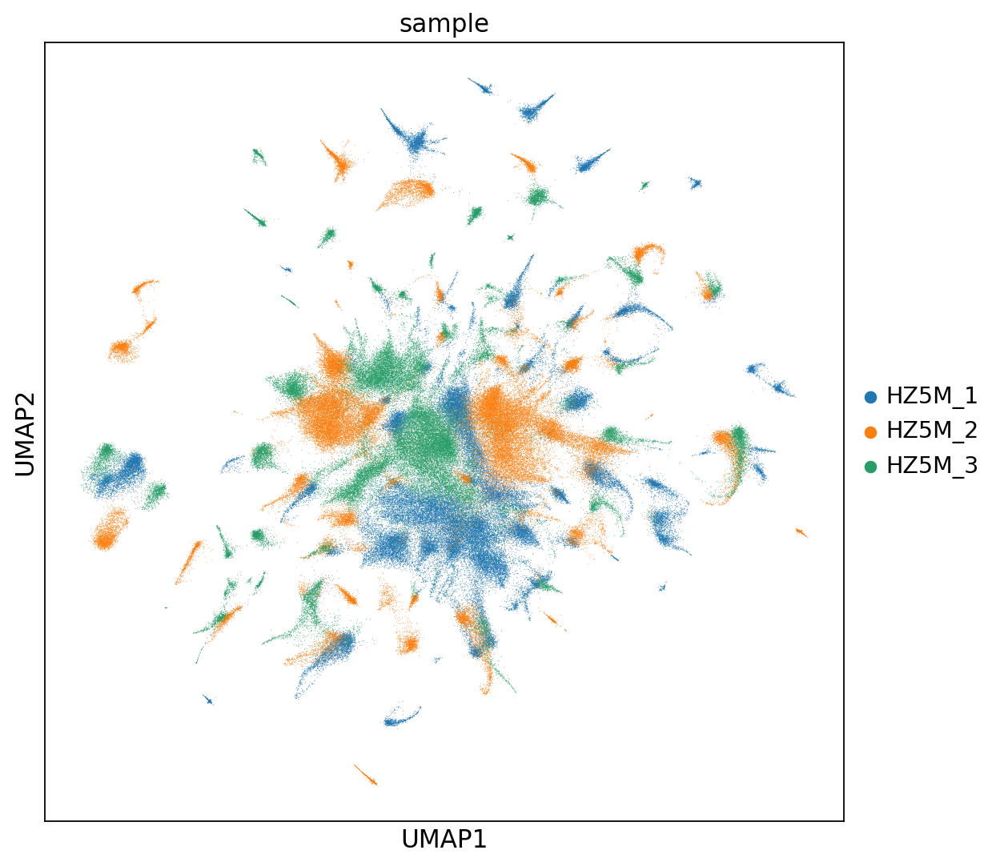

In [173]:
sc.pl.umap(com_adata, color = "sample")

# Regress out the difference between samples (Wrong But use for Comparison)

In [81]:
slide = []
for key, adata in cellbins.items():
    if "Prefrontal cortex" in key:
        print(key)
        slide.append(adata)

HZ12M01_Prefrontal cortex
HZ2M01_Prefrontal cortex
HZ3M01_Prefrontal cortex
HZ4MP101_Prefrontal cortex
HZ5M01_Prefrontal cortex
HZ6MP101_Prefrontal cortex
HZ8M01_Prefrontal cortex


In [82]:
slide

[AnnData object with n_obs × n_vars = 37909 × 895
     obs: 'Unnamed: 0', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'fine', 'genotype', 'month', 'sample', 'slice', 'id_A', 'age', 'nearest_plaque', 'interval', 'min_center_dist', 'min_border_dist', 'plaque_region', 'celltype', 'nCount_SCT', 'nFeature_SCT', 'nearest_index', 'struct_id', 'acronym_x', 'id_B', 'atlas_id', 'name', 'acronym_y', 'st_level', 'ontology_id', 'hemisphere_id', 'weight', 'parent_structure_id', 'depth', 'graph_id', 'graph_order', 'structure_id_path', 'color_hex_triplet', 'neuro_name_structure_id', 'neuro_name_structure_id_path', 'failed', 'sphinx_id', 'structure_name_facet', 'failed_facet', 'safe_name', 'total_voxel_counts (10 um)', 'Structure independently delineated (not merged to form parents)', 'Major Division', '"Summary Structure" Level for Analyses', 'Structure Name', 'nCount_RNA', 'nFeature_RNA', 'batch', 'plaque', 'plaque_delta', 'percent.mito', 'percent.rb', 'RNA_snn_res.0

In [83]:
adata_combined = ad.concat(slide)

/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [86]:
adata_combined

AnnData object with n_obs × n_vars = 315755 × 166
    obs: 'Unnamed: 0', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'fine', 'genotype', 'month', 'sample', 'slice', 'id_A', 'age', 'nearest_plaque', 'interval', 'min_center_dist', 'min_border_dist', 'plaque_region', 'celltype', 'nCount_SCT', 'nFeature_SCT', 'nearest_index', 'struct_id', 'acronym_x', 'id_B', 'atlas_id', 'name', 'acronym_y', 'st_level', 'ontology_id', 'hemisphere_id', 'weight', 'parent_structure_id', 'depth', 'graph_id', 'graph_order', 'structure_id_path', 'color_hex_triplet', 'neuro_name_structure_id', 'neuro_name_structure_id_path', 'failed', 'sphinx_id', 'structure_name_facet', 'failed_facet', 'safe_name', 'total_voxel_counts (10 um)', 'Structure independently delineated (not merged to form parents)', 'Major Division', '"Summary Structure" Level for Analyses', 'Structure Name', 'nCount_RNA', 'nFeature_RNA', 'batch', 'plaque', 'plaque_delta', 'percent.mito', 'percent.rb', 'RNA_snn_res.0.

In [85]:
adata_combined.obs["sample"].unique()

['HZ12M_1', 'HZ2M_1', 'HZ3M_1', 'HZ4M_4', 'HZ5M_1', 'HZ6M_4', 'HZ8M_1']
Categories (7, object): ['HZ2M_1', 'HZ3M_1', 'HZ4M_4', 'HZ5M_1', 'HZ6M_4', 'HZ8M_1', 'HZ12M_1']

In [87]:
# Perform harmony integration
sc.tl.pca(adata_combined, svd_solver='arpack')

sc.external.pp.harmony_integrate(adata_combined, key="sample")

# Compute neighbors using the harmony-integrated PCA representation
sc.pp.neighbors(adata_combined, use_rep="X_pca_harmony")

# Compute UMAP
sc.tl.umap(adata_combined)

# Update UMAP coordinates to use the harmony-integrated ones
adata_combined.obsm["X_umap_harmony_sample"] = adata_combined.obsm["X_umap"]

computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:17)


2024-05-20 19:52:16,422 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-20 19:54:42,067 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-20 19:54:47,163 - harmonypy - INFO - Iteration 1 of 10
2024-05-20 20:02:44,110 - harmonypy - INFO - Iteration 2 of 10
2024-05-20 20:11:22,069 - harmonypy - INFO - Iteration 3 of 10
2024-05-20 20:15:15,408 - harmonypy - INFO - Iteration 4 of 10
2024-05-20 20:18:23,927 - harmonypy - INFO - Converged after 4 iterations


computing neighbors


/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:04:11)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:19:09)


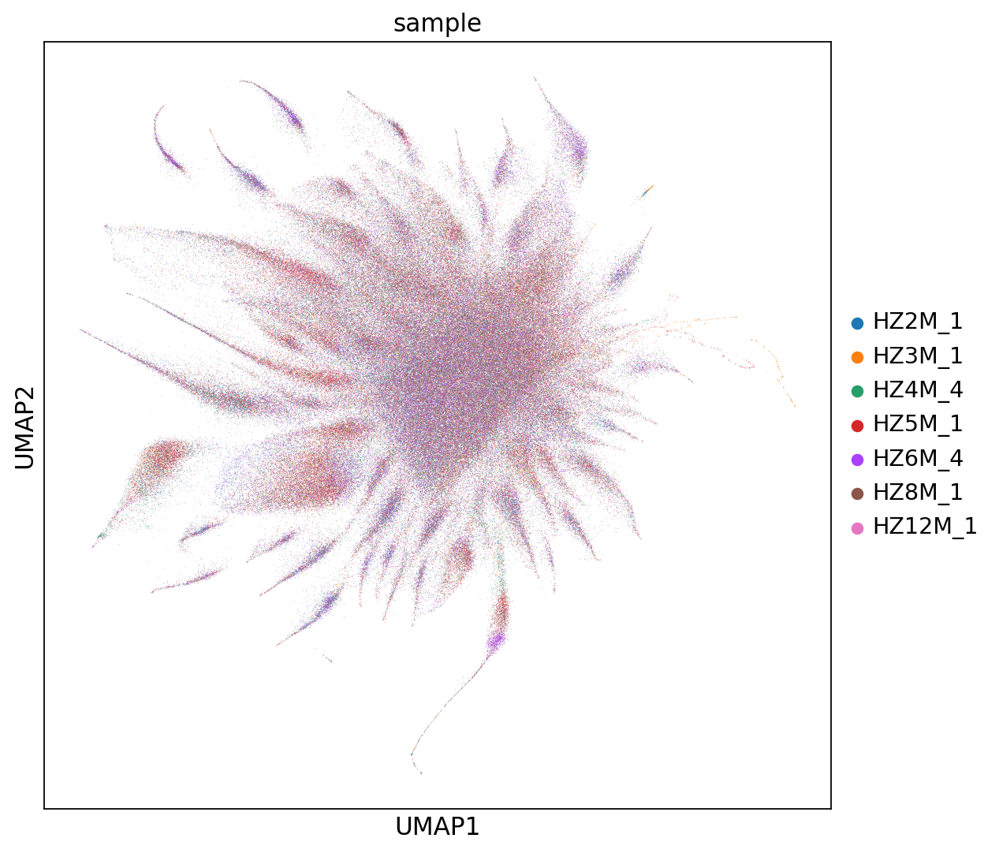

In [88]:
sc.pl.umap(adata_combined, color = "sample")

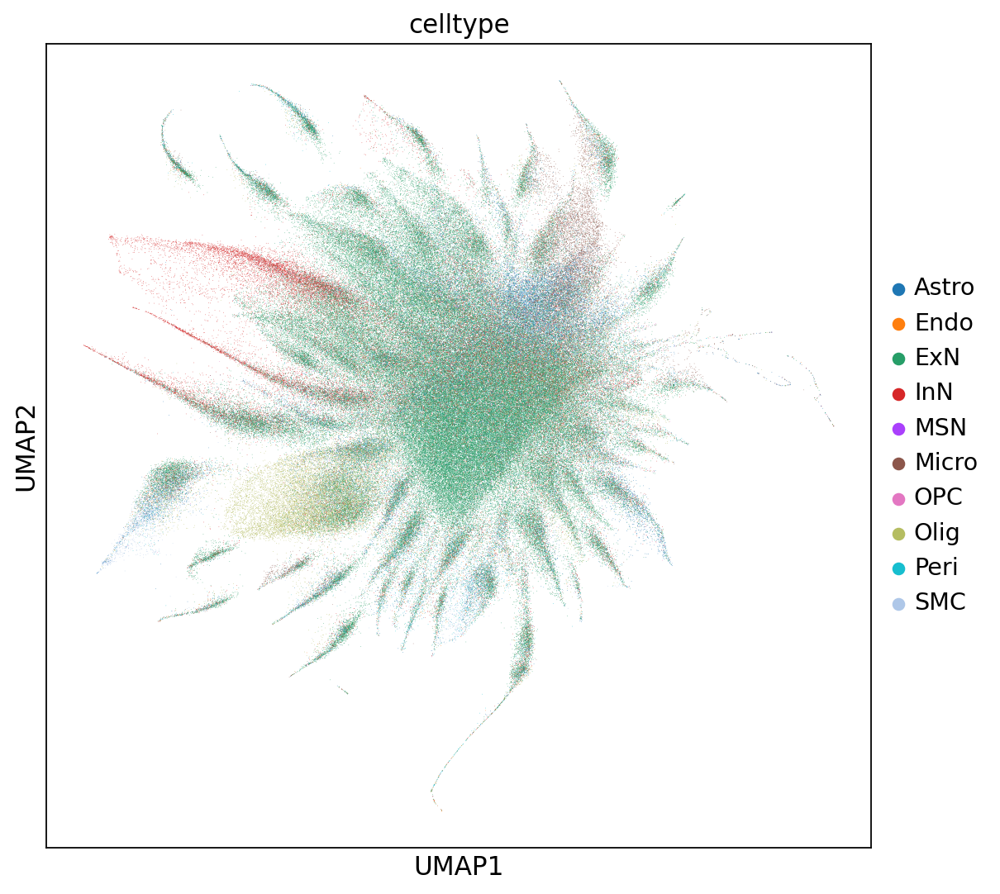

In [89]:
sc.pl.umap(adata_combined, color = "celltype")

# Corrected (Using Harmonized PCA)

In [90]:
correct = ad.concat(slide)

/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/public/home/jijh/micromamba/envs/seurat/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [92]:
correct

AnnData object with n_obs × n_vars = 315755 × 166
    obs: 'Unnamed: 0', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'orig.ident', 'x', 'y', 'fine', 'genotype', 'month', 'sample', 'slice', 'id_A', 'age', 'nearest_plaque', 'interval', 'min_center_dist', 'min_border_dist', 'plaque_region', 'celltype', 'nCount_SCT', 'nFeature_SCT', 'nearest_index', 'struct_id', 'acronym_x', 'id_B', 'atlas_id', 'name', 'acronym_y', 'st_level', 'ontology_id', 'hemisphere_id', 'weight', 'parent_structure_id', 'depth', 'graph_id', 'graph_order', 'structure_id_path', 'color_hex_triplet', 'neuro_name_structure_id', 'neuro_name_structure_id_path', 'failed', 'sphinx_id', 'structure_name_facet', 'failed_facet', 'safe_name', 'total_voxel_counts (10 um)', 'Structure independently delineated (not merged to form parents)', 'Major Division', '"Summary Structure" Level for Analyses', 'Structure Name', 'nCount_RNA', 'nFeature_RNA', 'batch', 'plaque', 'plaque_delta', 'percent.mito', 'percent.rb', 'RNA_snn_res.0.

In [93]:
sc.external.pp.harmony_integrate(correct, key="sample", basis = "X_pca_harmony", adjusted_basis="X_pca_harmony_2")

# Compute neighbors using the harmony-integrated PCA representation
sc.pp.neighbors(correct, use_rep="X_pca_harmony_2")

# Compute UMAP
sc.tl.umap(correct)

# Update UMAP coordinates to use the harmony-integrated ones
correct.obsm["X_umap_harmony_sample"] = correct.obsm["X_umap"]

2024-05-20 22:58:08,165 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-20 23:00:09,906 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-20 23:00:16,254 - harmonypy - INFO - Iteration 1 of 10
2024-05-20 23:08:48,650 - harmonypy - INFO - Iteration 2 of 10
2024-05-20 23:16:31,454 - harmonypy - INFO - Converged after 2 iterations


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:03:12)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:19:29)


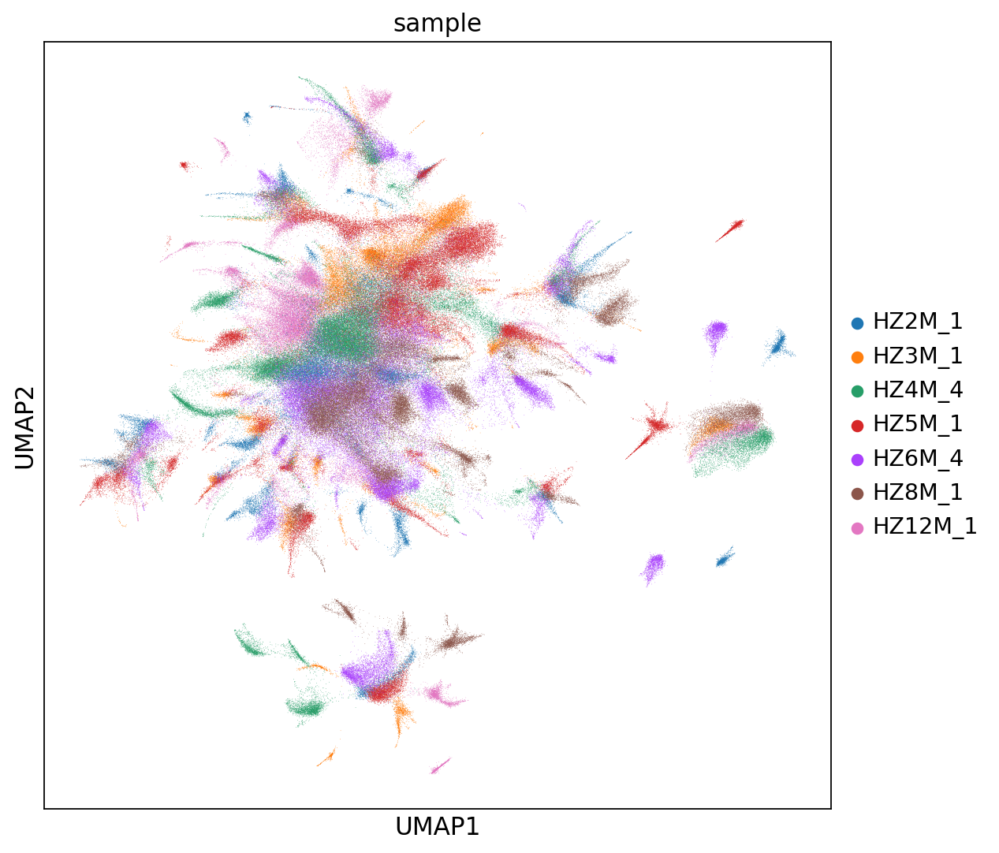

In [94]:
sc.pl.umap(correct, color = "sample")

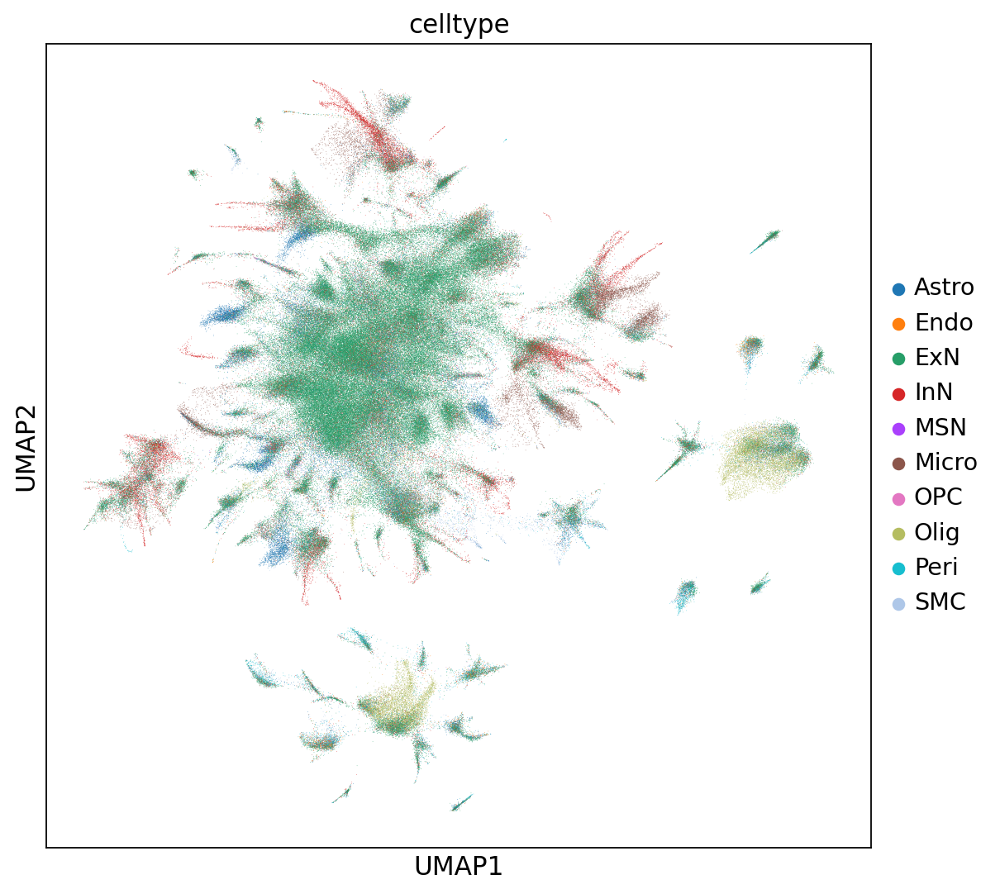

In [95]:
sc.pl.umap(correct, color = "celltype")